In [9]:
import pandas as pd 
import numpy as np 
import  seaborn as sns 
import plotly.express as px 
import matplotlib.pyplot  as  plt 
from sklearn.preprocessing import OneHotEncoder,MinMaxScaler,LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression,Ridge
from sklearn.ensemble import RandomForestRegressor,AdaBoostRegressor,GradientBoostingRegressor,BaggingRegressor
from xgboost import XGBRegressor
from sklearn.metrics import r2_score,mean_squared_error

In [10]:
clean_df = pd.read_csv('/home/codemaster29/Documents/Coding_Stuff/FlightWise/Models/data_set/Clean_Dataset.csv')

In [11]:
clean_df


,Unnamed: 0,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955
...,...,...,...,...,...,...,...,...,...,...,...,...
300148,300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265
300149,300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105
300150,300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099
300151,300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585


In [12]:
clean_df.columns

Index(['Unnamed: 0', 'airline', 'flight', 'source_city', 'departure_time',
       'stops', 'arrival_time', 'destination_city', 'class', 'duration',
       'days_left', 'price'],
      dtype='object')

In [13]:
fig = px.histogram(data_frame=clean_df,
                   x ='price',
                   nbins=20,marginal='box',
                   color_discrete_sequence=['#6c3483'],
                   text_auto=True,title='The Distribution of Flight Price')
fig.update_layout()
fig.show()

In [14]:
fig = px.histogram(data_frame=clean_df,
                   x ='price',
                   nbins=20,marginal='box',
                   color='class',
                   text_auto=True,title='The Distribution of Flight Price vs Class')
fig.update_layout()
fig.show()

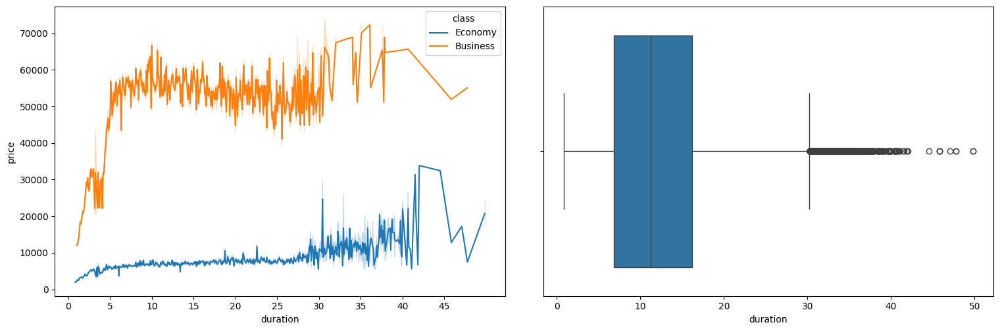

In [15]:
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
plt.tight_layout()
# Left ax
sns.lineplot(x='duration', y='price', data=clean_df, ax=ax[0], hue='class').set_xticks(np.arange(0, 50, 5))
# Right AX
sns.boxplot(data=clean_df, x='duration', ax=ax[1])
plt.show()

<Axes: xlabel='airline', ylabel='price'>

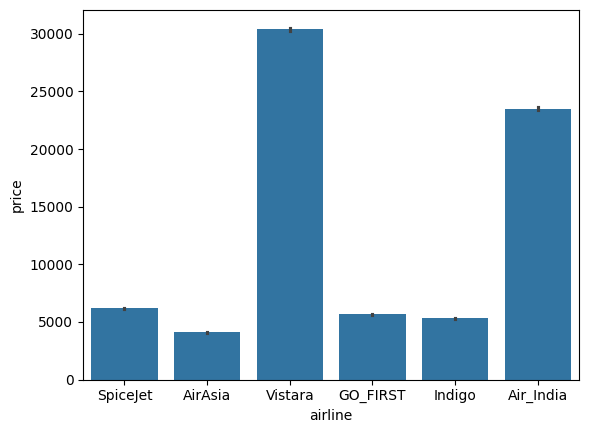

In [16]:
sns.barplot(data=clean_df,x='airline',y='price')

Text(0.5, 1.0, 'Source_city by Frequency')

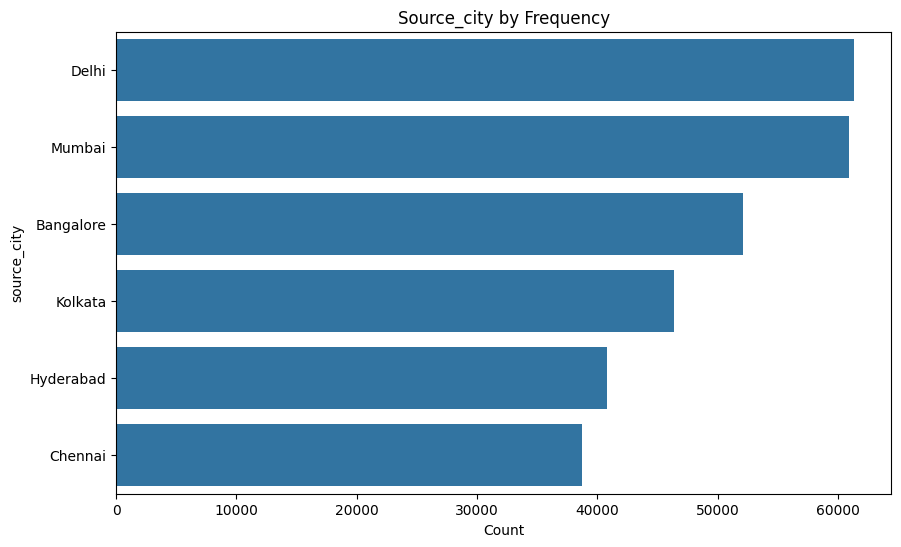

In [17]:
source_count =clean_df.source_city.value_counts().reset_index(name='Count')
plt.figure(figsize=(10,6))
sns.barplot(data=source_count,y='source_city',x='Count')
plt.title("Source_city by Frequency")

Text(0.5, 1.0, 'Destination_city by Frequency')

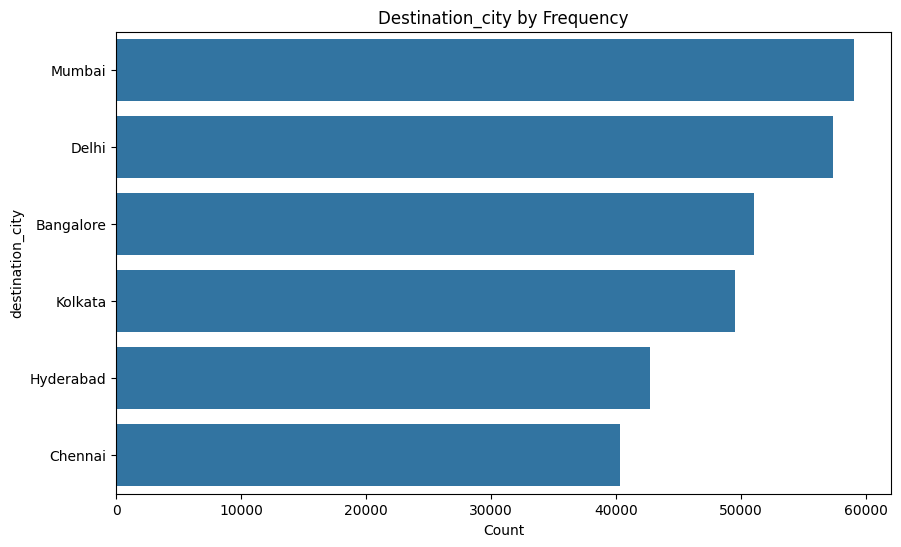

In [18]:
city_count =clean_df.destination_city.value_counts().reset_index(name='Count')
plt.figure(figsize=(10,6))
sns.barplot(data=city_count,y='destination_city',x='Count')
plt.title("Destination_city by Frequency")

In [19]:
fig = px.scatter(data_frame=clean_df,
                 x='days_left',
                 y='price',
                 color='source_city',
                 title='Days left vs Price based on Source city'
                )
fig.show()

In [20]:
fig = px.scatter(data_frame=clean_df,
                 x='days_left',
                 y='price',
                 color='destination_city',
                 title='Days left vs Price based on Destination_city'
                )
fig.show()

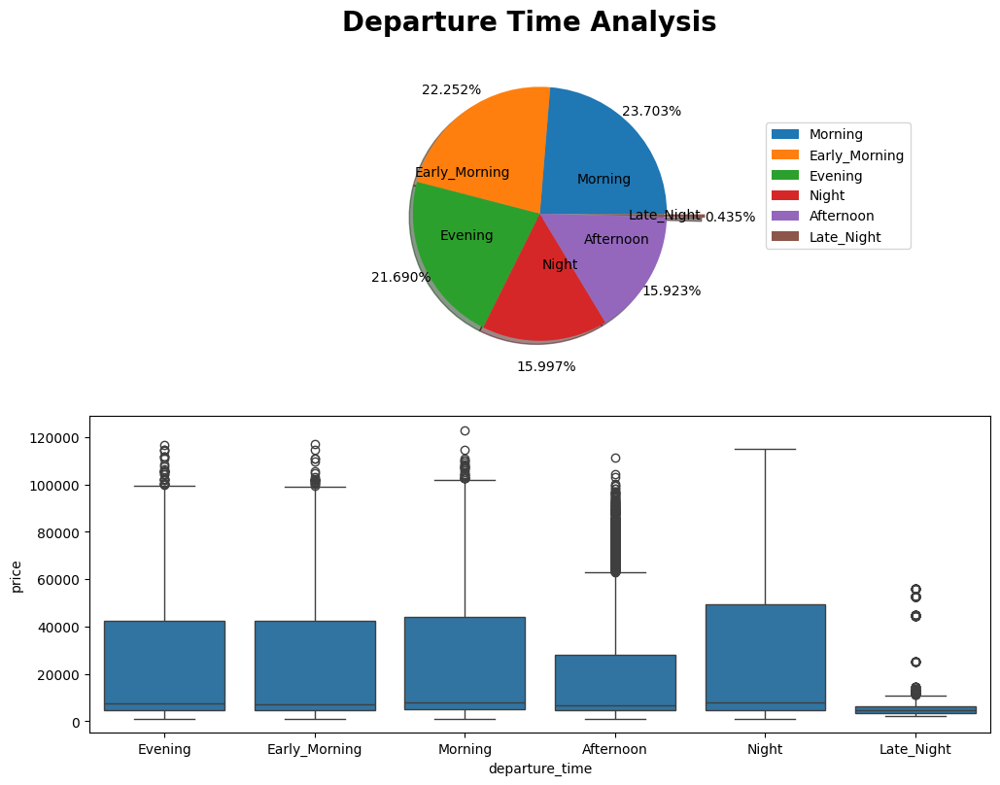

In [21]:
fig, ax = plt.subplots(2, 1, figsize=(10, 8))
fig.suptitle('Departure Time Analysis', fontsize=20, fontweight='bold')
plt.tight_layout()
# Top ax
labels = clean_df.departure_time.value_counts().index.tolist()
explode = (0, 0, 0, 0, 0, 0.3)
ax[0].pie(clean_df.departure_time.value_counts(), autopct='%.3f%%', labels=labels, shadow=True, pctdistance=1.2, labeldistance=0.4, explode=explode)
ax[0].legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=5)

# Bottom ax
sns.boxplot(x='departure_time', y='price', data=clean_df, ax=ax[1])
plt.show()

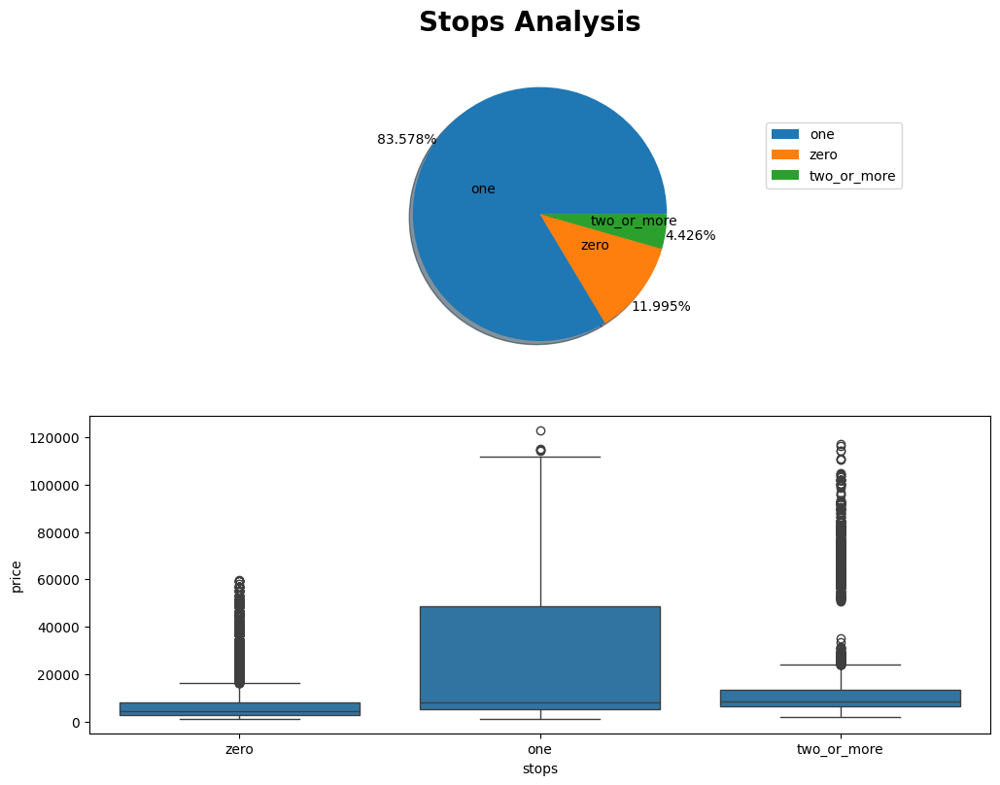

In [22]:
fig, ax = plt.subplots(2, 1, figsize=(10, 8))
fig.suptitle('Stops Analysis', fontsize=20, fontweight='bold')
plt.tight_layout()
# Top ax
labels = clean_df.stops.value_counts().index.tolist()

ax[0].pie(clean_df.stops.value_counts(), autopct='%.3f%%', labels=labels, shadow=True, pctdistance=1.2, labeldistance=0.4)
ax[0].legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=5)

# Bottom ax
sns.boxplot(x='stops', y='price', data=clean_df, ax=ax[1])
plt.show()

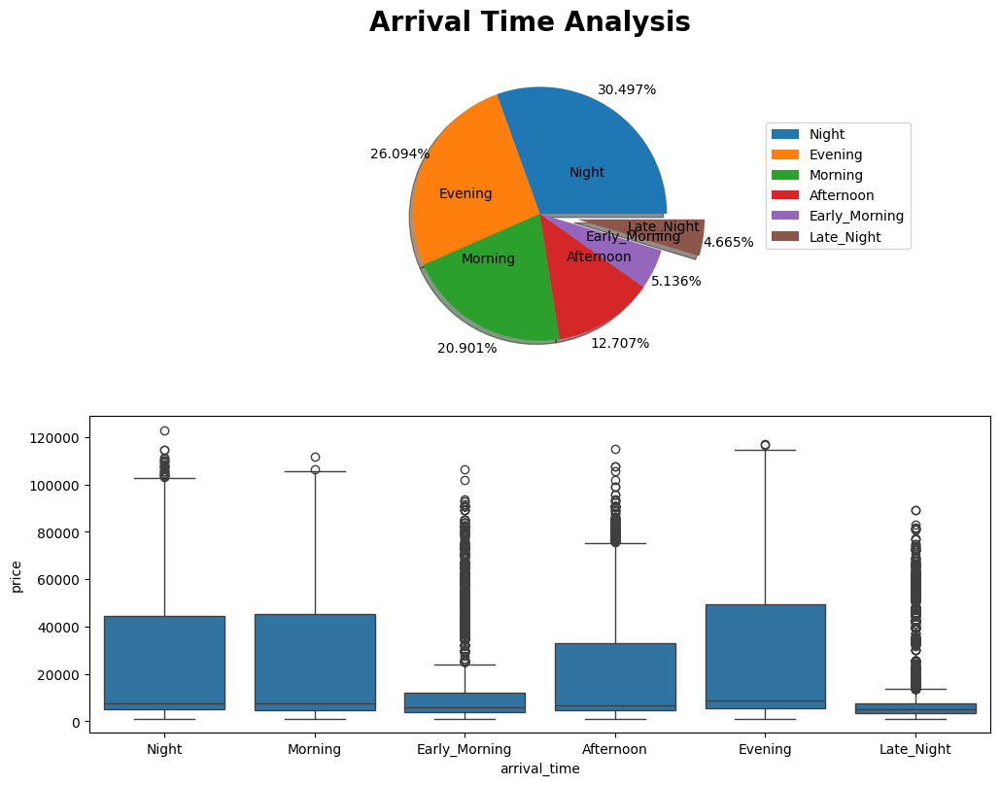

In [23]:
fig, ax = plt.subplots(2, 1, figsize=(10, 8))
fig.suptitle('Arrival Time Analysis', fontsize=20, fontweight='bold')
plt.tight_layout()
# Top ax
labels = clean_df.arrival_time.value_counts().index.tolist()
explode = (0, 0, 0, 0, 0, 0.3)
ax[0].pie(clean_df.arrival_time.value_counts(), autopct='%.3f%%', labels=labels, shadow=True, pctdistance=1.2, labeldistance=0.4, explode=explode)
ax[0].legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=5)

# Bottom ax
sns.boxplot(x='arrival_time', y='price', data=clean_df, ax=ax[1])
plt.show()

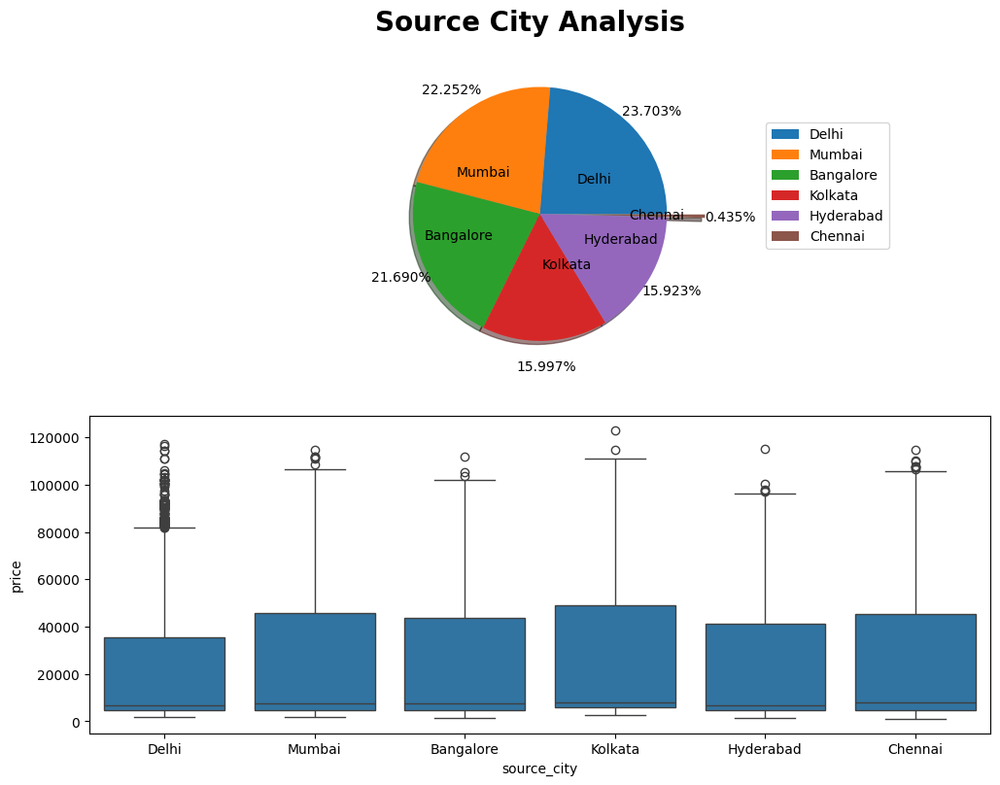

In [24]:
fig, ax = plt.subplots(2, 1, figsize=(10, 8))
fig.suptitle('Source City Analysis', fontsize=20, fontweight='bold')
plt.tight_layout()
# Top ax
labels = clean_df.source_city.value_counts().index.tolist()
explode = (0, 0, 0, 0, 0, 0.3)
ax[0].pie(clean_df.departure_time.value_counts(), autopct='%.3f%%', labels=labels, shadow=True, pctdistance=1.2, labeldistance=0.4, explode=explode)
ax[0].legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=5)

# Bottom ax
sns.boxplot(x='source_city', y='price', data=clean_df, ax=ax[1])
plt.show()

In [25]:
# remove the outlier
clean_df = clean_df[clean_df.price <=100000]


In [26]:
clean_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 300045 entries, 0 to 300152
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        300045 non-null  int64  
 1   airline           300045 non-null  object 
 2   flight            300045 non-null  object 
 3   source_city       300045 non-null  object 
 4   departure_time    300045 non-null  object 
 5   stops             300045 non-null  object 
 6   arrival_time      300045 non-null  object 
 7   destination_city  300045 non-null  object 
 8   class             300045 non-null  object 
 9   duration          300045 non-null  float64
 10  days_left         300045 non-null  int64  
 11  price             300045 non-null  int64  
dtypes: float64(1), int64(3), object(8)
memory usage: 29.8+ MB


In [27]:
clean_df.nunique()

Unnamed: 0          300045
airline                  6
flight                1561
source_city              6
departure_time           6
stops                    3
arrival_time             6
destination_city         6
class                    2
duration               476
days_left               49
price                12088
dtype: int64

In [28]:
clean_df.columns

Index(['Unnamed: 0', 'airline', 'flight', 'source_city', 'departure_time',
       'stops', 'arrival_time', 'destination_city', 'class', 'duration',
       'days_left', 'price'],
      dtype='object')

In [29]:
inputs_cols=['airline',  'source_city', 'departure_time','stops', 'arrival_time',
            'destination_city', 'class', 'duration','days_left', ]
targets_col='price'

In [30]:
inputs_dataset = clean_df[inputs_cols].copy()
targets_set    = clean_df[targets_col].copy()

In [31]:
numeric_cols = inputs_dataset.select_dtypes(include=np.number).columns.tolist()
categorical_cols = inputs_dataset.select_dtypes(include='object').columns.tolist()

In [32]:
scaler = MinMaxScaler()
scaler.fit(inputs_dataset[numeric_cols])
inputs_dataset[numeric_cols] = scaler.transform(inputs_dataset[numeric_cols])

In [33]:
encoder = OneHotEncoder(sparse_output=False,handle_unknown='ignore')
encoder.fit(inputs_dataset[categorical_cols])
encoder_cols = encoder.get_feature_names_out(categorical_cols)
inputs_dataset[encoder_cols]=encoder.transform(inputs_dataset[categorical_cols])

In [34]:
X = pd.concat([inputs_dataset[numeric_cols], inputs_dataset[encoder_cols]],axis=1)
y = targets_set

In [35]:
xtrain,xtest,ytrain,ytest = train_test_split(X,y,test_size=.20,random_state=42)

In [36]:
lr = LinearRegression()
lr.fit(xtrain,ytrain)

LinearRegression()

In [37]:
lr.predict(xtest)

array([ 5440.,  3160., 51304., ..., 10896., 11648.,  8552.])

In [38]:
lr_score= r2_score(ytest,lr.predict(xtest))
lr_score

0.9126618475109027

In [39]:
# pick different model and test which is better 
Linear_reg = LinearRegression(),
Ride_reg= Ridge()
XGBoost = XGBRegressor()
Random_forest = RandomForestRegressor()
Ada_boost = AdaBoostRegressor()
Grad_boost = GradientBoostingRegressor()
Bagging= BaggingRegressor()   

In [40]:
model_li = [Ride_reg,XGBoost,Random_forest,Ada_boost,Grad_boost,Bagging]

In [41]:
Score =[]
for model in model_li:
    model.fit(xtrain,ytrain)
    Score.append(r2_score(ytest,model.predict(xtest)))

In [42]:
 Score.append(lr_score) 

In [43]:
Score

[0.9126649205332987,
 0.9783280491828918,
 0.986205725871212,
 0.9275429552186473,
 0.9540028261192842,
 0.9852371032432768,
 0.9126618475109027]

Text(0.5, 1.0, 'R2 Score Analysis ')

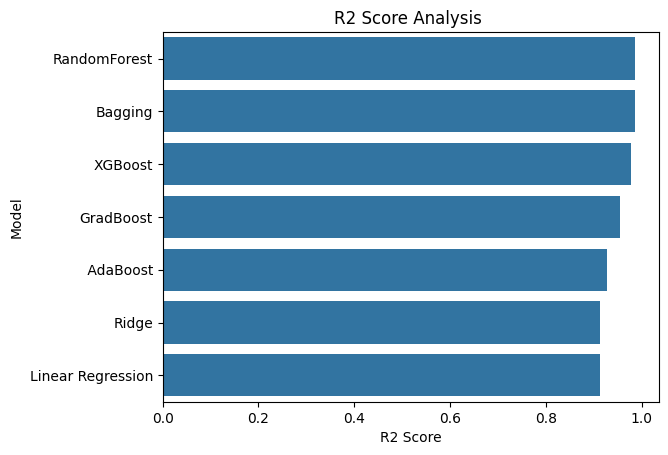

In [44]:
# pick a best model
di={
    "Model":['Ridge','XGBoost','RandomForest',' AdaBoost','GradBoost',
             'Bagging','Linear Regression'],
   "R2 Score":Score}

score_df = pd.DataFrame(di)
score_df=score_df.nlargest(columns='R2 Score',n=7)
sns.barplot(data=score_df,y="Model",x='R2 Score')
plt.title("R2 Score Analysis ")

In [45]:
# our Final Model  

Random_forest.fit(xtrain,ytrain)
print("The R2 score of Random Forest : ",r2_score(ytest,Random_forest.predict(xtest)))

The R2 score of Random Forest :  0.9861305824539881


## Create a single prediction



In [46]:
new_input = {
    'airline':'Vistara', 
    'flight':'UK-822',
    'source_city':'Chennai', 
    'departure_time':'Morning',
    'stops':'one', 
    'arrival_time':'Evening', 
    'destination_city':'Hyderabad', 
    'class':'Business', 
    'duration':10.00,   
    'days_left':49

}

In [47]:
new_df = pd.DataFrame([new_input])
new_df

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left
0,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.0,49


In [48]:
new_df[numeric_cols] = scaler.transform(new_df[numeric_cols])
new_df[encoder_cols]=encoder.transform(new_df[categorical_cols])
X = pd.concat([new_df[numeric_cols], new_df[encoder_cols]],axis=1)

In [49]:
X

,duration,days_left,airline_AirAsia,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara,source_city_Bangalore,source_city_Chennai,...,arrival_time_Morning,arrival_time_Night,destination_city_Bangalore,destination_city_Chennai,destination_city_Delhi,destination_city_Hyderabad,destination_city_Kolkata,destination_city_Mumbai,class_Business,class_Economy
0,0.187143,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [50]:
pred = Random_forest.predict(X)
pred

array([75980.90333333])

In [51]:
def make_prediction(single_input):
    new_df = pd.DataFrame([new_input])
    new_df[numeric_cols] = scaler.transform(new_df[numeric_cols])
    new_df[encoder_cols]=encoder.transform(new_df[categorical_cols])
    X = pd.concat([new_df[numeric_cols], new_df[encoder_cols]],axis=1)
    pred = Random_forest.predict(X)
    print("The price of the ticket is : ",pred[0])

In [52]:
make_prediction(new_input)

The price of the ticket is :  75980.90333333334


## saving the model

In [53]:
!pip install joblib

import joblib

In [56]:
import joblib

In [57]:
model_elements ={
    'model':Random_forest,
    'scaler': scaler,
    'encoder': encoder,
    'input_cols': inputs_cols,
    'target_col': targets_col,
    'numeric_cols': numeric_cols,
    'categorical_cols': categorical_cols,
    'encoded_cols': encoder_cols
}

In [58]:
joblib.dump(model_elements,"Flight ticket model.joblib")

['Flight ticket model.joblib']

In [59]:
model_load = joblib.load("Flight ticket model.joblib")

In [60]:
test_preds = model_load['model'].predict(xtest)
test_preds

array([ 8606.81,  3806.4 , 59938.38, ...,  6654.28, 13771.76,  5441.  ])

In [61]:
r2_score(ytest,test_preds)

0.9861305824539881